# **Reference**
**아래 코드는 https://github.com/lukemelas/Automatic-Image-Colorization/ 의 코드를 바탕으로하여 만든 코드입니다.**

# **0. Basics**
해당 코드를 돌리기 위한 기본적인 사항들 입니다.

(Ex : import module, 구글드라이브 마운트, 변수선언, 유용한 함수선언 등)

In [ ]:
# For plotting
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.animation as animation
from IPython.display import HTML
# For conversion
from skimage.color import lab2rgb, rgb2lab, rgb2gray 
from skimage import io
# For everything
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.utils as vutils
# For our model
import torchvision.models as models
from torchvision import datasets, transforms
# For utilities
import os, shutil, time, sys, random
# Too ignore warning
import warnings
warnings.simplefilter("ignore", UserWarning)

device = 'cuda' if torch.cuda.is_available() else 'cpu'
best_losses = 1e+6 # lowest validation loss
current_epoch = 0  # start from epoch 0 or last checkpoint epoch
train_loss_list = [] # training loss list
val_loss_list = [] # validation loss list
lr_list = [] # learning rate list
if torch.cuda.is_available():
  print("현재 사용중인 GPU : {}".format(torch.cuda.get_device_name(0)))
else:
  print("현재 GPU를 사용하고 있지 않습니다.")
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

현재 사용중인 GPU : Tesla P100-PCIE-16GB
Random Seed:  999


In [ ]:
# 구글 드라이브 마운트 - 이하 코드는 구글 코랩에서 작업하기 위한 코드들입니다. 로컬에서 작업하실거면 무시하셔도 됩니다.
from google.colab import drive
drive.mount('/content/drive')
os.chdir("/content/drive/My Drive/딥러닝 기초 플젝")
sys.path.append('/content/drive/My Drive/딥러닝 기초 플젝')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
class AverageMeter(object):
    '''A handy class from the PyTorch ImageNet tutorial''' 
    def __init__(self):
        self.reset()
    def reset(self):
        self.val, self.avg, self.sum, self.count = 0, 0, 0, 0
    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

def to_rgb(grayscale_input, ab_input):
    '''Show/save rgb image from grayscale and ab channels
     Input save_path in the form {'grayscale': '/path/', 'colorized': '/path/'}'''
    plt.clf() # clear matplotlib 
    color_image = torch.cat((grayscale_input, ab_input), 1) # combine channels

    for i in range(0, len(color_image)):
        color_image[i] = torch.from_numpy(lab2rgb(color_image[i].permute(1, 2, 0).numpy())).permute(2, 0, 1)
    grayscale_input = grayscale_input.squeeze().numpy()
    
    return color_image

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 8

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 256

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0001

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# **1. Loading dataset**

## 1.1 Custom Dataset

지정된 경로에 있는 모든 이미지를 갖고있는 객체를 만드는 클래스입니다. 예를들어



```
train_imagefolder = GrayscaleImageFolder('./dataset/train/', train_transforms)
```

위 코드는 './dataset/train/(아무폴더)'디렉토리에 있는 모든 이미지를 모은 객체를 생성합니다.

이때 우리가 불러오고자하는 이미지들은 반드시 train폴더가 아닌 train폴더안의 (아무폴더)에 들어있어야 합니다.


한편 transforms는 Data augmentation을 적용하기 위한 argument입니다. 


```
train_imagefolder[idx]
```
위 코드는 해당 객체의 idx번째 이미지로부터 (Grayscale된 이미지), (ab 이미지), (원본 이미지)를 반환합니다.



In [ ]:
class GrayscaleImageFolder(datasets.ImageFolder):
  '''Custom images folder, which converts images to grayscale before loading'''
  def __getitem__(self, index):
    path, target = self.imgs[index]
    img = self.loader(path)
    if self.transform is not None:
        img = self.transform(img)
    img = np.asarray(img)
    img_lab = rgb2lab(img)
    img_ab = img_lab[:, :, 1:3]
    img_ab = torch.from_numpy(img_ab).float().permute(2, 0, 1)
    # 2 * 256 * 256
    img_gray = img_lab[:, :, 0]
    img_gray = torch.from_numpy(img_gray).unsqueeze(0).float()
    # 1 * 256 * 256
    if self.target_transform is not None:
        target = self.target_transform(target)
    return img_gray, img_ab, img, target

## 1.2 Data Augmentation & Loading

Data Augmentation(데이터 증강)을 적용하고 데이터를 로드하는 코드입니다. 
Data Augmentation은 transform_augmentation을 수정하여 바꿀 수 있습니다. 예를들어



```
train_transforms = transforms.Compose([
    transforms.RandomResizedCrop(256),
    transforms.RandomHorizontalFlip()])
```
위 코드는

(1) 원본 이미지에서 256 * 256 만큼 Randomcrop하고

(2) 일정확률로 위 아래를 뒤집기

하는 역할을 합니다.

Pytorch에서 기본적으로 지원하는 Augmentation 기법들은 https://pytorch.org/docs/stable/torchvision/transforms.html 에서 확인할 수 있습니다.

In [ ]:
# Training
print('Loading Training data...', end=' ')
train_transforms = transforms.Compose([
    transforms.RandomResizedCrop((256, 256), scale=(0.9, 1.0)),
    transforms.RandomHorizontalFlip()])
train_imagefolder = GrayscaleImageFolder('./dataset/flower102/train', train_transforms)
train_loader = torch.utils.data.DataLoader(train_imagefolder, batch_size=batch_size, shuffle=True)
print("Done!")
print("Training data size : {}".format(len(train_imagefolder)))

# Validation 
print('Loading Validation data...', end=' ')
val_transforms = transforms.Compose([
    transforms.Resize((256,256)),])
val_imagefolder = GrayscaleImageFolder('./dataset/flower102/val', val_transforms)
val_loader = torch.utils.data.DataLoader(val_imagefolder, batch_size=batch_size, shuffle=False)
print("Done!")
print("Training data size : {}".format(len(val_imagefolder)))
val_batch = next(iter(val_loader))

# Test
print('Loading Test data...', end=' ')
test_transforms = transforms.Compose([
    transforms.Resize((256,256)),])
test_imagefolder = GrayscaleImageFolder('./dataset/flower102/test', val_transforms)
test_loader = torch.utils.data.DataLoader(val_imagefolder, batch_size=batch_size, shuffle=True)
print("Done!")
print("Training data size : {}".format(len(test_imagefolder)))
test_batch = next(iter(test_loader))

Loading Training data... Done!
Training data size : 6552
Loading Validation data... Done!
Training data size : 818
Loading Test data... Done!
Training data size : 167


## 1.3 Dataset Test

Dataset이 성공적으로 만들어졌는지 확인하는 코드입니다.
좌측 이미지가 원본이고 우측 이미지는 Grayscale 결과입니다.

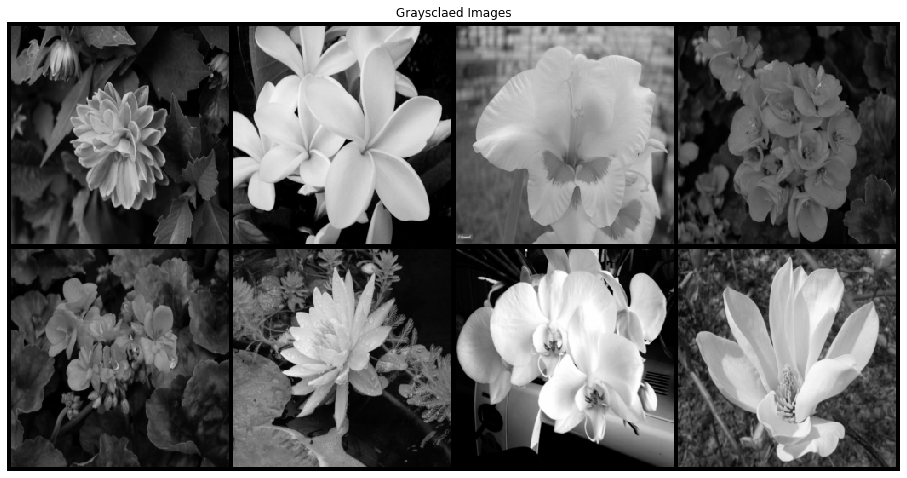

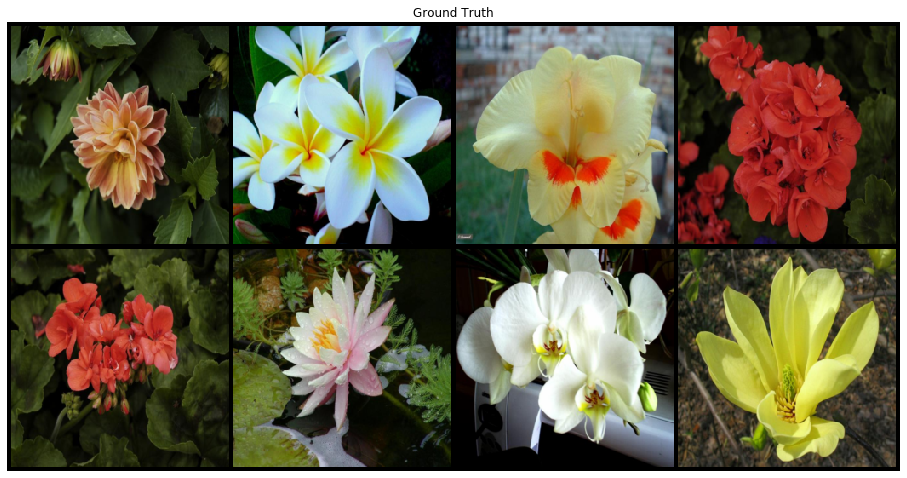

In [ ]:
import random
# Plot some training images
real_batch = next(iter(train_loader))

plt.figure(figsize=(16, 16))
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:16], nrow=4, padding=5, normalize=True).cpu(),(1,2,0)))
plt.axis("off")
plt.title("Graysclaed Images")
plt.show()

plt.figure(figsize=(16, 16))
plt.imshow(vutils.make_grid(to_rgb(real_batch[0], real_batch[1])[:16], nrow=4, padding=5, normalize=True).cpu().permute(1,2,0))
plt.axis("off")
plt.title("Ground Truth")

plt.show()

# **2. Construct the Model**

학습에 쓸 모델에 해당하는 코드입니다.

현재 프로토타입으로 쓰인 모델은 (인풋)-(인코더)-(디코더)-(아웃풋)으로 구성되어 있습니다.

인풋은 Grayscaled Image를 나타내는 1 * 256 * 256 의 Tensor입니다.

인코더는 1개 채널의 Input Tensor를 512개 채널을 가진 Feature Tensor로 변환하며 이 모델에서는 Resnet18을 사용하였습니다.

참고로 인코더가 Feature 추출을 더 잘하기 위해서, 먼저 Flower102 데이터셋에 대한 분류기로 Pre-train시켰습니다. 
(Validation Accuracy 89.120%)

디코더는 Feature Tensor를 다시 2 * 256 * 256 의 Output Tensor로 변환하며 Convolutional Layer와 Upsampling Layer로 구성되어있습니다.

## 2.1 ColorizationNet

Input이 통과할 전체 모델입니다.

(Reference : https://github.com/harshitbansal05/Image-Colorization/blob/master/model.py)

In [ ]:
# Resnet
def conv3x3(in_planes, out_planes, stride=1, groups=1, dilation=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=dilation, groups=groups, bias=False, dilation=dilation)


def conv1x1(in_planes, out_planes, stride=1):
    """1x1 convolution"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=1, stride=stride, bias=False)


class BasicBlock(nn.Module):
    expansion = 1
    __constants__ = ['downsample']

    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1,
                 base_width=64, dilation=1, norm_layer=None):
        super(BasicBlock, self).__init__()
        if norm_layer is None:
            norm_layer = nn.BatchNorm2d
        if groups != 1 or base_width != 64:
            raise ValueError('BasicBlock only supports groups=1 and base_width=64')
        if dilation > 1:
            raise NotImplementedError("Dilation > 1 not supported in BasicBlock")
        # Both self.conv1 and self.downsample layers downsample the input when stride != 1
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = norm_layer(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = norm_layer(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out


class Bottleneck(nn.Module):
    expansion = 4
    __constants__ = ['downsample']

    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1,
                 base_width=64, dilation=1, norm_layer=None):
        super(Bottleneck, self).__init__()
        if norm_layer is None:
            norm_layer = nn.BatchNorm2d
        width = int(planes * (base_width / 64.)) * groups
        # Both self.conv2 and self.downsample layers downsample the input when stride != 1
        self.conv1 = conv1x1(inplanes, width)
        self.bn1 = norm_layer(width)
        self.conv2 = conv3x3(width, width, stride, groups, dilation)
        self.bn2 = norm_layer(width)
        self.conv3 = conv1x1(width, planes * self.expansion)
        self.bn3 = norm_layer(planes * self.expansion)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out


class ResNet(nn.Module):

    def __init__(self, block, layers, num_classes=1000, zero_init_residual=False,
                 groups=1, width_per_group=64, replace_stride_with_dilation=None,
                 norm_layer=None):
        super(ResNet, self).__init__()
        if norm_layer is None:
            norm_layer = nn.BatchNorm2d
        self._norm_layer = norm_layer

        self.inplanes = 64
        self.dilation = 1
        if replace_stride_with_dilation is None:
            # each element in the tuple indicates if we should replace
            # the 2x2 stride with a dilated convolution instead
            replace_stride_with_dilation = [False, False, False]
        if len(replace_stride_with_dilation) != 3:
            raise ValueError("replace_stride_with_dilation should be None "
                             "or a 3-element tuple, got {}".format(replace_stride_with_dilation))
        self.groups = groups
        self.base_width = width_per_group
        self.conv1 = nn.Conv2d(3, self.inplanes, kernel_size=7, stride=2, padding=3,
                               bias=False)
        self.bn1 = norm_layer(self.inplanes)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2,
                                       dilate=replace_stride_with_dilation[0])
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2,
                                       dilate=replace_stride_with_dilation[1])
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2,
                                       dilate=replace_stride_with_dilation[2])

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)

        # Zero-initialize the last BN in each residual branch,
        # so that the residual branch starts with zeros, and each residual block behaves like an identity.
        # This improves the model by 0.2~0.3% according to https://arxiv.org/abs/1706.02677
        if zero_init_residual:
            for m in self.modules():
                if isinstance(m, Bottleneck):
                    nn.init.constant_(m.bn3.weight, 0)
                elif isinstance(m, BasicBlock):
                    nn.init.constant_(m.bn2.weight, 0)

    def _make_layer(self, block, planes, blocks, stride=1, dilate=False):
        norm_layer = self._norm_layer
        downsample = None
        previous_dilation = self.dilation
        if dilate:
            self.dilation *= stride
            stride = 1
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                conv1x1(self.inplanes, planes * block.expansion, stride),
                norm_layer(planes * block.expansion),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample, self.groups,
                            self.base_width, previous_dilation, norm_layer))
        self.inplanes = planes * block.expansion
        for _ in range(1, blocks):
            layers.append(block(self.inplanes, planes, groups=self.groups,
                                base_width=self.base_width, dilation=self.dilation,
                                norm_layer=norm_layer))

        return nn.Sequential(*layers)

    def _forward(self, x):
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        #print(x1.size())
        x2 = self.maxpool(x1)
        x2 = self.layer1(x2)
        #print(x2.size())
        x3 = self.layer2(x2)
        #print(x3.size())
        x4 = self.layer3(x3)
        #print(x4.size())
        x5 = self.layer4(x4)
        #print(x5.size())
        return (x5, x4, x3, x2, x1)

    # Allow for accessing forward method in a inherited class
    forward = _forward


def _resnet(arch, block, layers, pretrained, progress, **kwargs):
    model = ResNet(block, layers, **kwargs)
    if pretrained:
        state_dict = load_state_dict_from_url(model_urls[arch],
                                              progress=progress)
        model.load_state_dict(state_dict)
    return model


def resnet18(pretrained=False, progress=True, **kwargs):
    r"""ResNet-18 model from
    `"Deep Residual Learning for Image Recognition" <https://arxiv.org/pdf/1512.03385.pdf>`_

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
    """
    return _resnet('resnet18', BasicBlock, [2, 2, 2, 2], pretrained, progress,
                   **kwargs)

def resnet50(pretrained=False, progress=True, **kwargs):
    r"""ResNet-50 model from
    `"Deep Residual Learning for Image Recognition" <https://arxiv.org/pdf/1512.03385.pdf>`_

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
    """
    return _resnet('resnet50', Bottleneck, [3, 4, 6, 3], pretrained, progress,
                   **kwargs)

def resnet101(pretrained=False, progress=True, **kwargs):
    r"""ResNet-101 model from
    `"Deep Residual Learning for Image Recognition" <https://arxiv.org/pdf/1512.03385.pdf>`_

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
    """
    return _resnet('resnet101', Bottleneck, [3, 4, 23, 3], pretrained, progress,
                   **kwargs)

In [ ]:
class ColorizationNet(nn.Module):
    def __init__(self):
        super(ColorizationNet, self).__init__()
        class Generator(nn.Module):
            def __init__(self):
                super(Generator, self).__init__()
                class Encoder(nn.Module):
                    def __init__(self):
                        super(Encoder, self).__init__()
                        # Build ResNet and change first conv layer to accept single-channel input
                        self.resnet = resnet50()
                        self.resnet.conv1.weight = nn.Parameter(self.resnet.conv1.weight.sum(dim=1).unsqueeze(1).data)

                    def forward(self, input_image):
                        # Pass input through ResNet-gray to extract features
                        output = self.resnet(input_image)
                        return output

                class Decoder(nn.Module):
                    def __init__(self):
                        super(Decoder, self).__init__()
                        # Fusion layer to combine midlevel and global features

                        # Convolutional layers and upsampling
                        self.conv1 = nn.Conv2d(3072, 768, kernel_size=3, stride=1, padding=1)
                        self.bn1 = nn.BatchNorm2d(768)
                        self.conv2 = nn.Conv2d(1280, 320, kernel_size=3, stride=1, padding=1)
                        self.bn2 = nn.BatchNorm2d(320)
                        self.conv3 = nn.Conv2d(576, 144, kernel_size=3, stride=1, padding=1)
                        self.bn3 = nn.BatchNorm2d(144)
                        self.conv4 = nn.Conv2d(208, 52, kernel_size=3, stride=1, padding=1)
                        self.bn4 = nn.BatchNorm2d(52)     
                        self.conv5 = nn.Conv2d(52, 2, kernel_size=3, stride=1, padding=1)

                        self.upsample = nn.Upsample(scale_factor=2)

                    def forward(self, midlevel_input): #, global_input):
                        x5 = midlevel_input[0]
                        x4 = midlevel_input[1]
                        x3 = midlevel_input[2]
                        x2 = midlevel_input[3]
                        x1 = midlevel_input[4]

                        # Convolutional layers and upsampling
                        x = self.upsample(x5) 
                        #print(x.size()) # 512 * 16 * 16
                        x = torch.cat((x4, x), 1) 
                        #print(x.size()) # 768 * 16 * 16
                        x = F.relu(self.bn1(self.conv1(x))) 
                        #print(x.size()) # 384 * 16 * 16

                        x = self.upsample(x) 
                        #print(x.size()) # 384 * 32 * 32
                        x = torch.cat((x3, x), 1) 
                        #print(x.size()) # 512 * 32 * 32
                        x = F.relu(self.bn2(self.conv2(x)))
                        #print(x.size()) # 256 * 32 * 32

                        x = self.upsample(x) 
                        #print(x.size()) # 256 * 64 * 64
                        x = torch.cat((x2, x), 1) 
                        #print(x.size()) # 320 * 64 * 64
                        x = F.relu(self.bn3(self.conv3(x)))
                        #print(x.size()) # 160 * 64 * 64

                        x = self.upsample(x) 
                        #print(x.size()) # 96 * 128 * 128
                        x = torch.cat((x1, x), 1) 
                        #print(x.size()) # 224 * 128 * 128
                        x = F.relu(self.bn4(self.conv4(x)))
                        #print(x.size()) # 112 * 128 * 128

                        x = self.upsample(x)
                        #print(x.size()) # 112 * 256 * 256

                        x = F.tanh(self.conv5(x)) *128
                        #print(x.size()) # 2 * 256 * 256
                        return x

                self.encoder = Encoder()
                self.decoder = Decoder()

            def forward(self, input):
                encode = self.encoder(input)
                output = self.decoder(encode)

                return output

        class Discriminator(nn.Module):
            def __init__(self):
                super(Discriminator, self).__init__()
                self.main = nn.Sequential(
                    # input is 3 x 256 x 256
                    nn.Conv2d(3, 32, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(32),
                    nn.LeakyReLU(0.2, inplace=True),
                    # state size. 32 x 128 x 128
                    nn.Conv2d(32, 64, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(64),
                    nn.LeakyReLU(0.2, inplace=True),
                    # state size. 64 x 64 x 64
                    nn.Conv2d(64, 128, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(128),
                    nn.LeakyReLU(0.2, inplace=True),
                    # state size. 128 x 32 x 32
                    nn.Conv2d(128, 256, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(0.2, inplace=True),
                    # state size. 256 x 16 x 16
                    nn.Conv2d(256, 512, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(512),
                    nn.LeakyReLU(0.2, inplace=True),   
                    # state size. 512 x 8 x 8
                    nn.Conv2d(512, 1024, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(1024),
                    nn.LeakyReLU(0.2, inplace=True),                 
                    # state size. 1024 x 4 x 4
                    nn.Conv2d(1024, 2048, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(2048),
                    nn.LeakyReLU(0.2, inplace=True),    
                    # state size. 2048 x 8 x 8
                    nn.Conv2d(2048, 1, 4, 1, 1, bias=False),     
                    nn.Sigmoid()
                )

            def forward(self, input):
                output = self.main(input)

                return output.view(-1, len(output))
            
        # Create the Discriminator
        self.netG = Generator().to(device)
        self.netD = Discriminator().to(device)

        # Apply the weights_init function to randomly initialize all weights
        #  to mean=0, stdev=0.2.
        #self.netG.apply(weights_init)
        self.netD.apply(weights_init)

model = ColorizationNet()
model = model.to(device)
num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
for param in model.netG.encoder.parameters():
    param.requires_grad = True
torch.backends.cudnn.benchmark = True
print(model)
print('Number of parameters: %d' % (num_params))

ColorizationNet(
  (netG): Generator(
    (encoder): Encoder(
      (resnet): ResNet(
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (layer1): Sequential(
          (0): Bottleneck(
            (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, t

# **3. Save / Load the model**

## 3.1 Save the model
./checkpoint/ 디렉토리에 현재 모델을 'ckpt.pth'파일로 저장합니다.

In [ ]:
def save(model, epoch, best_losses):
    global G_losses, D_losses, img_list
    print('Saving...', end=' ')
    state = {
        'state_dict': model.state_dict(),
        'epoch': epoch,
        'best_losses' : best_losses,
        'G_losses' : G_losses,
        'D_losses' : D_losses,
        'img_list' : img_list,
        }
    if not os.path.isdir('checkpoint'):
        os.mkdir('checkpoint')
    torch.save(state, './checkpoint/ckpt.pth')
    print("Done!")

In [ ]:
print("Current epoch : {}, Current best_losses : {}".format(current_epoch, best_losses))
save(model, current_epoch, best_losses)

Current epoch : 0, Current best_losses : 1000000.0
Saving... Done!


In [ ]:
def save_netG(model):
    global train_loss_list, val_loss_list, lr_list, img_list
    print('Saving...', end=' ')
    
    if not os.path.isdir('checkpoint'):
        os.mkdir('checkpoint')
        
    state = {
        'state_dict': model.state_dict(),
        }
    torch.save(state, './checkpoint/generator/ckpt_after_gan.pth')
    print("Done!")
    
save_netG(model.netG)

Saving... Done!


## 3.2 Load the model
./checkpoint/ 디렉토리에 현재 모델을 'ckpt.pth'파일을 불러옵니다.

In [ ]:
def load(model):
    global current_epoch, best_losses, G_losses, D_losses, img_list
    print('Loading...', end=' ')
    assert os.path.isdir('checkpoint'), 'Error: no checkpoint directory found!'
    checkpoint = torch.load('./checkpoint/ckpt.pth')
    model.load_state_dict(checkpoint['state_dict'], strict=True)
    current_epoch = checkpoint['epoch']
    best_losses = checkpoint['best_losses']
    G_losses = checkpoint['G_losses'] 
    D_losses = checkpoint['D_losses']
    img_list = checkpoint['img_list']
    model.eval()
    print("Done!")
    


In [ ]:
load(model)
print("Current epoch : {}, Current best_losses : {}".format(current_epoch, best_losses))
num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('Number of parameters: %d' % (num_params))

Loading... Done!
Current epoch : 6, Current best_losses : 3.8715736865997314
Number of parameters: 94041206


## 3.3 Load the pre-trained generator

미리 학습된 generator를 가져옵니다.

In [ ]:
def encoder_load(model):
    print('Loading...', end=' ')
    assert os.path.isdir('checkpoint'), 'Error: no checkpoint directory found!'
    checkpoint = torch.load('./checkpoint/encoder/flower102_resnet50_encoder_94.621.pth')
    model.load_state_dict(checkpoint['state_dict'], strict=False)
    model.eval()
    print("Done!")

def generator_load(model):
    print('Loading...', end=' ')
    assert os.path.isdir('checkpoint'), 'Error: no checkpoint directory found!'
    checkpoint = torch.load('./checkpoint/generator/ckpt_resnet50.pth')
    model.load_state_dict(checkpoint['state_dict'], strict=True)
    model.eval()
    print("Done!")

def discriminator_load(model):
    global current_epoch, best_losses, train_loss_list, val_loss_list
    print('Loading...', end=' ')
    checkpoint = torch.load('./checkpoint/discriminator/ckpt.pth')
    model.load_state_dict(checkpoint['state_dict'], strict=True)
    model.eval()
    print("Done!")    

#encoder_load(model.netG)
generator_load(model.netG)
#discriminator_load(model.netD)
for param in model.netG.encoder.parameters():
    param.requires_grad = True
#for param in model.netD.parameters():
    #param.requires_grad = False
num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('Number of parameters: %d' % (num_params))
torch.backends.cudnn.benchmark = True

Loading... Done!
Number of parameters: 94041206


In [ ]:
with torch.no_grad():
    temp_real = torch.cat((test_batch[0], test_batch[1]), dim=1).to(device)
    print(model.netD(temp_real))

    temp_fake = torch.cat((test_batch[0].to(device), model.netG(test_batch[0].to(device))), dim=1).to(device)
    print(model.netD(temp_fake))

    #plt.figure(figsize=(32,32))
    #plt.imshow(np.transpose(vutils.make_grid(temp_fake.to(device)[:16], nrow=4, padding=2, normalize=True).cpu(), (1,2,0)))
    
    print(model.netD(temp_real).mean())
    print(model.netD(temp_fake).mean())

tensor([[0.6174, 0.8456, 0.9250, 0.9551, 0.4027, 0.7759, 0.9662, 0.7090]],
       device='cuda:0')
tensor([[0.5083, 0.9539, 0.8844, 0.9730, 0.6192, 0.8834, 0.9589, 0.8241]],
       device='cuda:0')
tensor(0.7746, device='cuda:0')
tensor(0.8256, device='cuda:0')


# **4. Train the Model**

## 4.1 Set hyperparameters, optimizer, loss, etc.

하이퍼파라미터, Loss Function, 옵티마이저, epoch 등을 결정합니다.

In [ ]:
# 반복할 epoch 수
epoch_num = 10
# learning rate
lr = 5e-7
# Initialize BCELoss function
criterion = nn.BCELoss()
criterion_l1 = nn.SmoothL1Loss()
# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(32, 100, 1, 1, device=device) 
# Beta1 hyperparam for Adam optimizers
beta1 = 0.5
# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0
# Setup Adam optimizers for both G and D
optimizerD = torch.optim.Adam(model.netD.parameters(), lr=lr*100)
optimizerG = torch.optim.Adam(model.netG.parameters(), lr=lr)

## 4.2 Train and validate the model

모델을 트레이닝하여 매 에폭마다 Validation Loss를 측정합니다.

만약 Validation Loss가 최저값으로 갱신되면 모델을 저장합니다.

In [ ]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
rho = 0.1
best_losses = 1e6

In [ ]:
# Training Loop

print("Starting Training Loop...")
# For each epoch
for epoch in range(epoch_num):
    # For each batch in the dataloader
    for i, data in enumerate(train_loader, 0):
        # Check how the generator is doing by saving G's output on fixed_noise

        if (iters % 500 == 0): #or ((epoch == epoch_num-1) and (i == len(train_loader)-1)):
            fake_img = to_rgb(val_batch[0], model.netG(val_batch[0].to(device)).detach().cpu()).to(device)
            img_list.append(vutils.make_grid(fake_img, padding=2, nrow=4, normalize=True))
        
        start_time = time.time()
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        for k in range(0, 1):
            model.netD.zero_grad()
            # Format batch
            real_cpu = torch.cat((data[0], data[1]), dim=1).to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, device=device).float()
            # Forward pass real batch through D
            output = model.netD(real_cpu)
            # Calculate loss on all-real batch
            errD_real = criterion(output, label)
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item()

            ## Train with all-fake batch
            # Generate batch of latent vectors
            noise = torch.randn(b_size, 1, 64, 64, device=device)
            # Generate fake image batch with G
            fake_ab = model.netG(data[0].to(device))
            fake = torch.cat((data[0].to(device), fake_ab), dim=1).to(device)
            label = torch.full((b_size,), fake_label, device=device).float()
            # Classify all fake batch with D
            output = model.netD(fake)
            # Calculate D's loss on the all-fake batch
            errD_fake = criterion(output, label)
            # Calculate the gradients for this batch
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            # Add the gradients from the all-real and all-fake batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()
        
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ############################
        for k in range(0, 1):
            model.netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            # Generate fake image batch with G
            fake_ab = model.netG(data[0].to(device))
            fake = torch.cat((data[0].to(device), fake_ab), dim=1).to(device)
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = model.netD(fake)
            # Calculate G's loss based on this output
            errG = rho*criterion(output, label.float()) + criterion_l1(fake_ab, data[1].to(device))
            #print("compare", rho*criterion(output, label.float()), criterion_l1(fake_ab, data[1].to(device)))
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            # Update G
            optimizerG.step()


        
        end_time = time.time()
        # Output training stats
        print('\r [%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f\tTime : %.3f'
              % (epoch, epoch_num, i, len(train_loader),
                 errD.item(), errG.item(), D_x, D_G_z1, D_G_z2, end_time - start_time), end='')

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if errG.item()<best_losses:
          print()
          best_losses = errG.item()
          save(model, epoch, best_losses)

        iters += 1 
    print()

Starting Training Loop...
 [0/10][0/819]	Loss_D: 1.6906	Loss_G: 7.2946	D(x): 0.3266	D(G(z)): 0.2684 / 0.2684	Time : 1.245
Saving... Done!
 [0/10][1/819]	Loss_D: 1.8940	Loss_G: 6.6576	D(x): 0.4009	D(G(z)): 0.4115 / 0.4115	Time : 1.208
Saving... Done!
 [0/10][12/819]	Loss_D: 1.8679	Loss_G: 6.1705	D(x): 0.3354	D(G(z)): 0.3325 / 0.3325	Time : 1.187
Saving... Done!
 [0/10][14/819]	Loss_D: 1.5932	Loss_G: 5.3880	D(x): 0.3770	D(G(z)): 0.3759 / 0.3759	Time : 1.207
Saving... Done!
 [0/10][50/819]	Loss_D: 1.5370	Loss_G: 5.2912	D(x): 0.4588	D(G(z)): 0.4148 / 0.4148	Time : 1.196
Saving... Done!
 [0/10][165/819]	Loss_D: 1.7056	Loss_G: 4.5234	D(x): 0.2867	D(G(z)): 0.2702 / 0.2702	Time : 1.228
Saving... Done!
 [0/10][818/819]	Loss_D: 1.6522	Loss_G: 6.8062	D(x): 0.3988	D(G(z)): 0.4527 / 0.4527	Time : 1.231
 [1/10][818/819]	Loss_D: 1.4862	Loss_G: 6.0036	D(x): 0.4499	D(G(z)): 0.4229 / 0.4229	Time : 1.179
 [2/10][161/819]	Loss_D: 1.5537	Loss_G: 4.1822	D(x): 0.4583	D(G(z)): 0.4564 / 0.4564	Time : 1.188
Sav

<Figure size 432x288 with 0 Axes>

## 5.1 Test an image

Validation 결과 이미지를 출력합니다. 좌측이 원본, 가운데가 Colorization, 오른쪽이 Grayscaled 입니다.

(또는 ./outputs/color 에서 확인할 수 있습니다.)

# **5. Show the results**

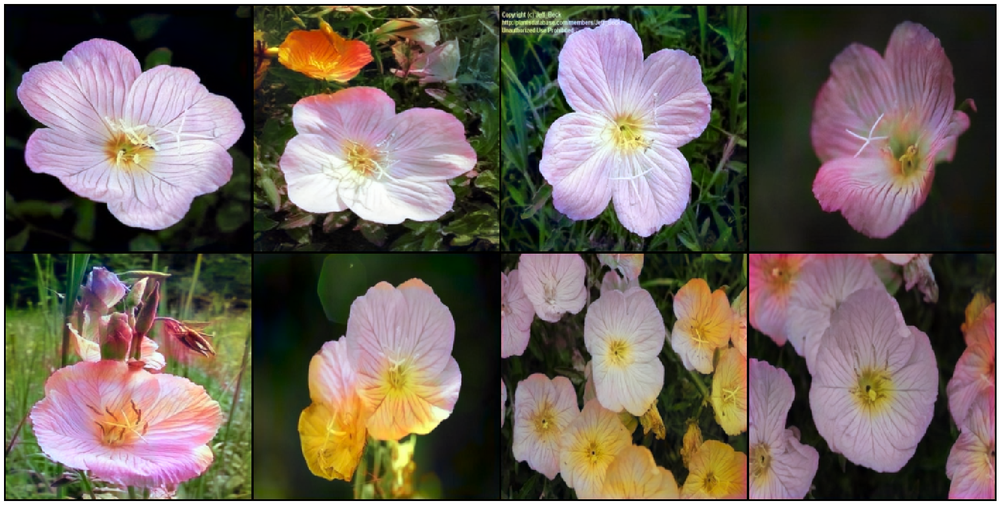

In [ ]:
#%%capture
plt.rcParams['animation.embed_limit'] = 2**128
fig = plt.figure(figsize=(32,16))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i.to('cpu').numpy(),(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=500, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Text(0.5, 1.0, 'Ground Truth')

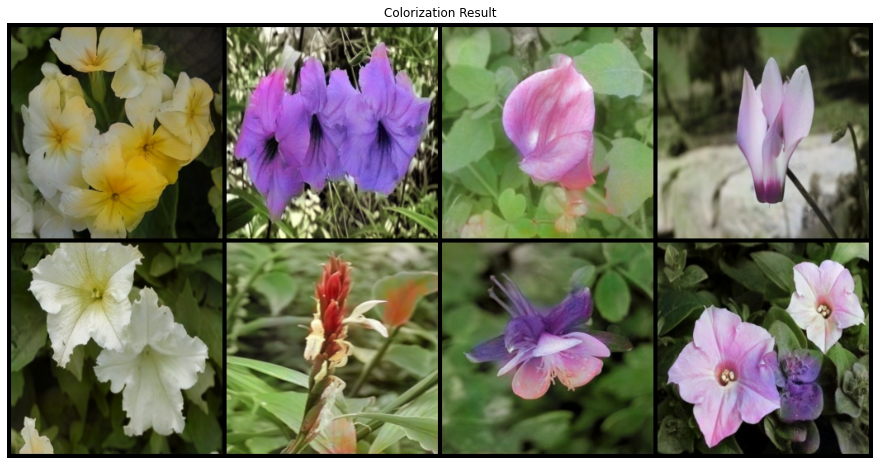

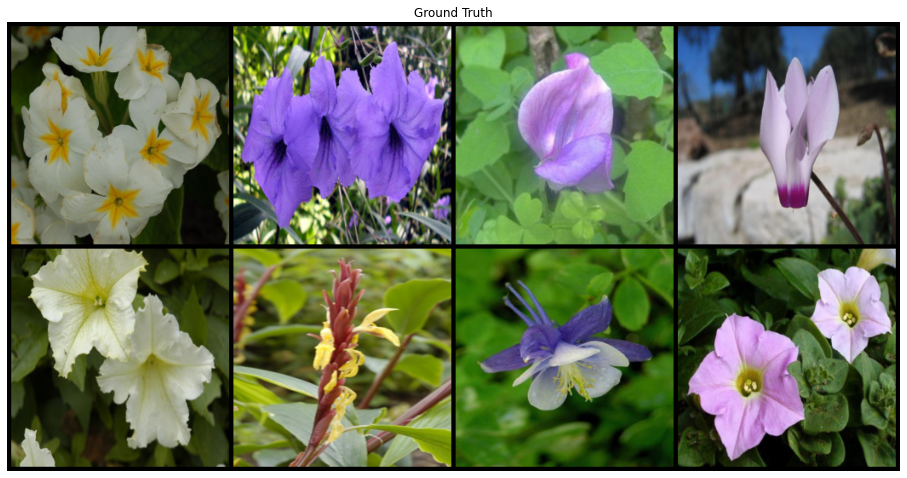

In [ ]:
#test_loader = torch.utils.data.DataLoader(val_imagefolder, batch_size=4, shuffle=True)
test_batch = next(iter(test_loader))

plt.figure(figsize=(16,8))
plt.imshow(vutils.make_grid(to_rgb(test_batch[0], model.netG(test_batch[0].to(device)).detach().cpu()).to(device), nrow=4, padding=5, normalize=True).cpu().permute(1,2,0))
plt.axis("off")
plt.title("Colorization Result")

plt.figure(figsize=(16,86))
plt.imshow(vutils.make_grid(to_rgb(test_batch[0], test_batch[1]), nrow=4, padding=5, normalize=True).cpu().permute(1,2,0))
plt.axis("off")
plt.title("Ground Truth")


## **5.2 Plot the losses**

Training Loss와 Validation Loss를 출력합니다.

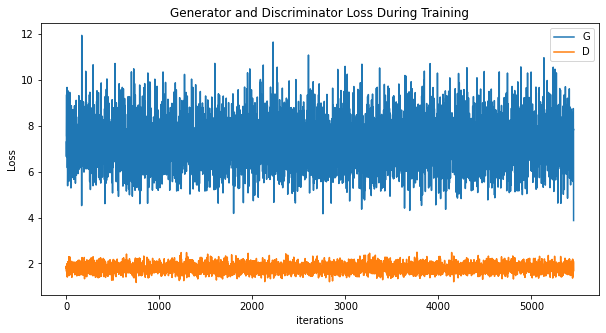

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

RuntimeError: The size of tensor a (3) must match the size of tensor b (2) at non-singleton dimension 0

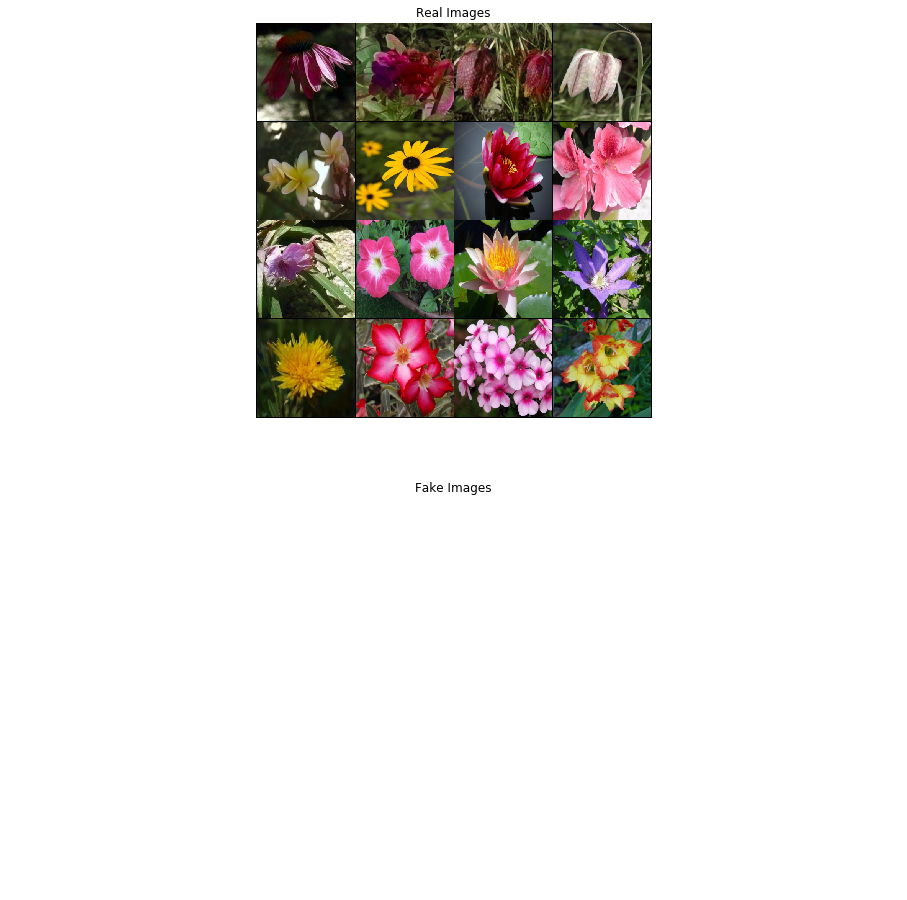

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(16,16))
plt.subplot(2,1,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[2].to(device)[:16], nrow=4, padding=2, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(2,1,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[1].to(device)[:16], nrow=4, padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# **6. Others**


## 6.1 Initialize record and model

current_epoch, best_losses, model을 초기화합니다.

In [ ]:
current_epoch = 0
best_losses = 100000
model = ColorizationNet()
model.to(device)

ColorizationNet(
  (netG): Generator(
    (encoder): Encoder(
      (resnet): ResNet(
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (layer1): Sequential(
          (0): Bottleneck(
            (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, t

In [ ]:
img_list = []
G_losses = []
D_losses = []
iters = 0

## 6.3 참고자료
[1] Colorful Image Colorization Richard Zhang, Phillip Isola, Alexei A. Efros 
(Submitted on 28 Mar 2016 (v1), last revised 5 Oct 2016 (this version, v5))
https://arxiv.org/abs/1603.08511

[2] Deep Colorization, Zezhou Cheng, Qingxiong Yang, Bin Sheng
(Submitted on 30 Apr 2016)
https://arxiv.org/abs/1605.00075

[3] Auto Colorization of Black and White Images using Machine Learning “Auto-encoders” technique https://medium.com/@mahmoudeljiddawi/auto-colorization-of-black-and-white-images-using-machine-learning-auto-encoders-technique-a213b47f7339